# Lab 2: Homography estimation and applications

In this lab you will learn how to estimate a homography relating two images given a set of correspondences between them. Then, you will work with different computer vision applications of the homography.

More precisely, the goals are:

1) Homography estimation with the DLT algorithm. <br>

2) Application: Image mosaics. <br>

3) Refinement of the estimated homography with the Gold Standard algorithm. <br>

4) Application: Camera calibration with a planar pattern and augmented reality. <br>

5) Application: Logo detection. <br>

6) Application: Logo replacement.

The following file combines some text cells (Markdown cells) and code cells. Some parts of the code need to be completed. All tasks you need to complete are marked in <span style='color:Green'> green.  </span>

In [1]:
import numpy as np
import cv2
import math
import sys
import matplotlib
from matplotlib import pyplot as plt
from operator import itemgetter
from typing import List, Tuple
from scipy.optimize import least_squares
from utils import apply_H_fixed_image_size
from utils import plot_img
from utils import draw_matches
from utils import Ransac_DLT_homography
from utils import kp_match
from utils import get_inliers_homography
from utils import create_mosaic
from utils import geometric_error_terms
from utils import get_geom_error_inputs
from utils import get_result_solution_ls
from utils import compute_geometric_error
from utils import show_points_refined
import logo_removal as LR
import copy

## **1. Homography estimation with the DLT algorithm**

### **1.1 Compute image correspondences**
Execute the following code to find image correspondences using ORB [1] (you may also use SIFT, SURF, etc)

[1] Ethan Rublee, Vincent Rabaud, Kurt Konolige, Gary R. Bradski: ORB: An efficient alternative to SIFT or SURF. ICCV 2011: 2564-2571.

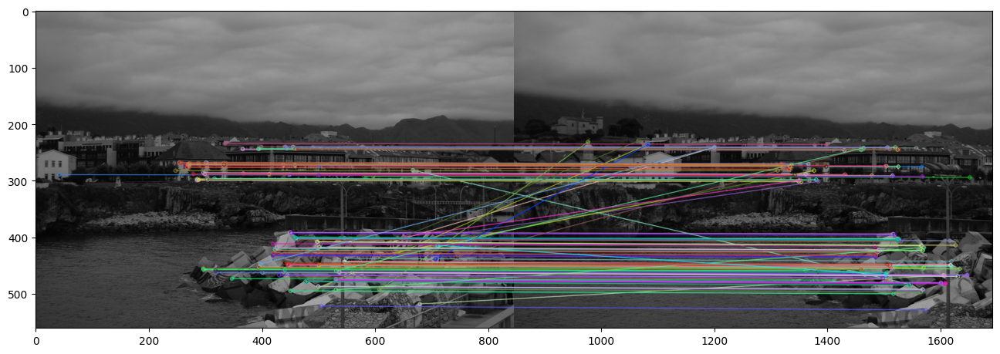

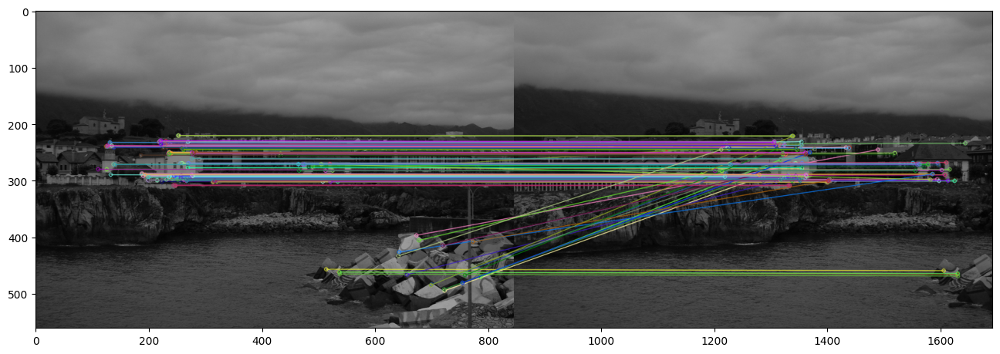

In [3]:
# Read images
img1_llanes = cv2.imread('Data/llanes/llanes_a.jpg',cv2.IMREAD_GRAYSCALE)
img2_llanes = cv2.imread('Data/llanes/llanes_b.jpg',cv2.IMREAD_GRAYSCALE)
img3_llanes = cv2.imread('Data/llanes/llanes_c.jpg',cv2.IMREAD_GRAYSCALE)

kp1, kp2, matches_12 = kp_match(img1_llanes, img2_llanes, descr='orb')
_, kp3, matches_23 = kp_match(img2_llanes, img3_llanes, descr='orb')

# Draw matches
draw_matches(img1_llanes, kp1 , img2_llanes, kp2, matches_12)
draw_matches(img2_llanes, kp2, img3_llanes, kp3, matches_23)

### **1.2 Compute the homography (DLT algorithm) between image pairs**

The following cell of code calls the 'Ransac_DLT_homography' function from utils.py. Before running the code of the cell you first need to complete some functions in utils.py that are called from 'Ransac_DLT_homography' function:

<span style='color:Green'> - Complete the 'DLT_homography' function that computes a homography from a set of point correspondences with the DLT algorithm.  </span>

<span style='color:Green'> - Complete the 'Inliers' function that, given a homography, a set of point correspondences and a certain threshold  returns the indices of the correspondences that are inliers.  </span>


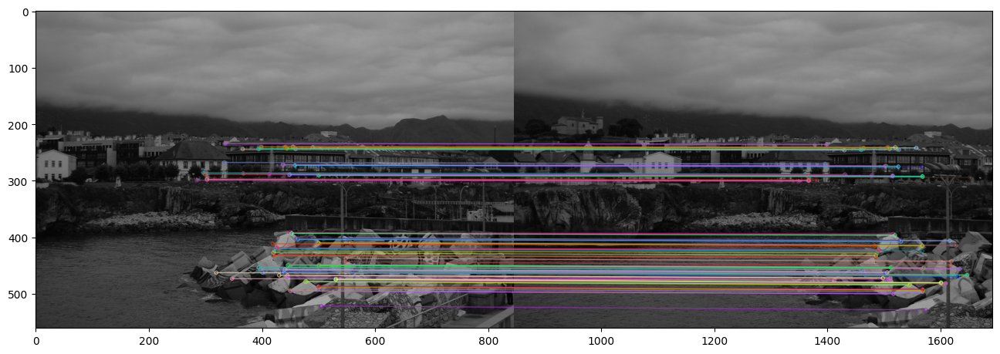

In [4]:
# Compute matches and homography for image pair 1 and 2
P1, P2, H_12, idxs_inlier_matches_12 = get_inliers_homography(kp1, kp2, matches_12)
inlier_matches_12 = itemgetter(*idxs_inlier_matches_12)(matches_12)

draw_matches(img1_llanes, kp1, img2_llanes, kp2, inlier_matches_12)

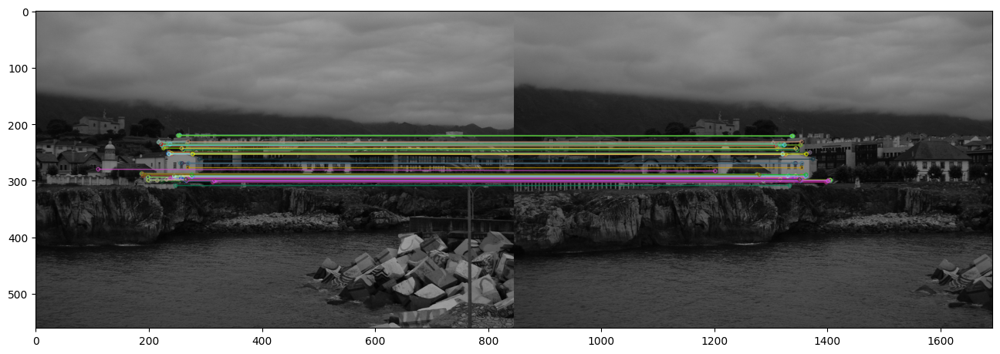

In [5]:
# Compute matches and homography for image pair 2 and 3
P2, P3, H_23, idxs_inlier_matches_23 = get_inliers_homography(kp2, kp3, matches_23)
inlier_matches_23 = itemgetter(*idxs_inlier_matches_23)(matches_23)

draw_matches(img2_llanes, kp2, img3_llanes, kp3, inlier_matches_23)

## **2. Application: Image mosaics**

Notice how we assumed that the scene `Llanes` we are considering is planar, and that all points we are considering lie on the same real 3D world plane. This is a reasonable assumption because the picture is taken from afar. If we did not assume that points lie on the same plane, we would be unable to properly relate them via a homography.

Once we have discovered the homographies that relate the different pairs of images, we may create a mosaic by transforming and combining the different images.

Thus, we set up a canvas that will contain the the mosai. Function `apply_H_fixed_image_size`, which is a modified version of Lab1's `apply_H`, is in file `utils.py`. The main difference is that the output size is fixed and passed as an input parameter.

<span style='color:Green'> - Complete the 2nd input argument to the 'apply_H_fixed_image_size' function in order to get the image mosaic. </span>

#### 2.1. Llanes

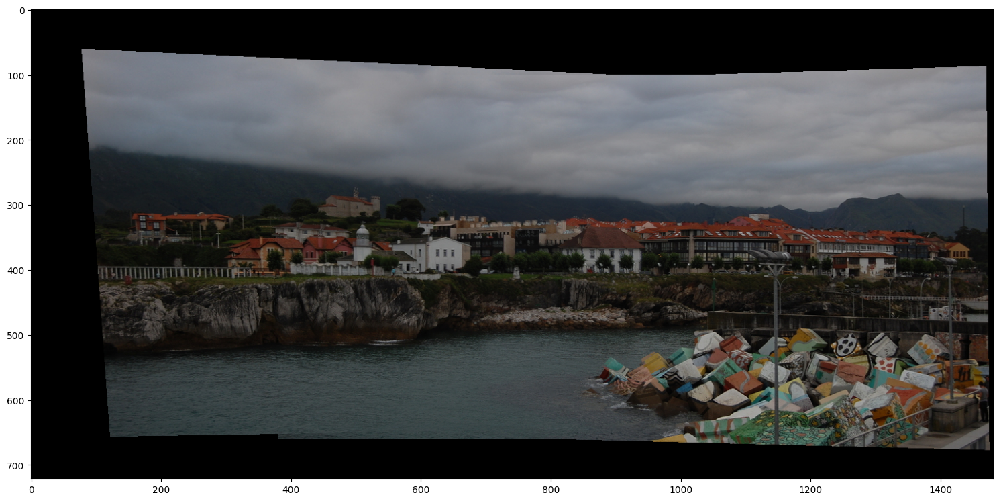

In [7]:
corners = [-380, 1100, -100, 620] # corners of the canvas where the mosaic will be created

img1_llanes = cv2.imread('Data/llanes/llanes_a.jpg', cv2.IMREAD_COLOR)
img2_llanes = cv2.imread('Data/llanes/llanes_b.jpg', cv2.IMREAD_COLOR)
img3_llanes = cv2.imread('Data/llanes/llanes_c.jpg', cv2.IMREAD_COLOR)

create_mosaic(img1_llanes, img2_llanes, img3_llanes, corners, H_12, H_23, out_filename='mosaic_llanes.png', store=True)

As previously noted, we assume the `Llanes` scene is planar, and that all points we are considering lie on the same real 3D world plane. Since the picture is taken from afar, this assumption is approximately valid. If we did not assume that points lie on the same plane, we would be unable to properly relate them via a homography.

The good results obtained (see image above) indicate that the assumption holds.

<span style='color:Green'> - Compute the mosaic with castle_int images. </span>

#### 2.2. Castle_int

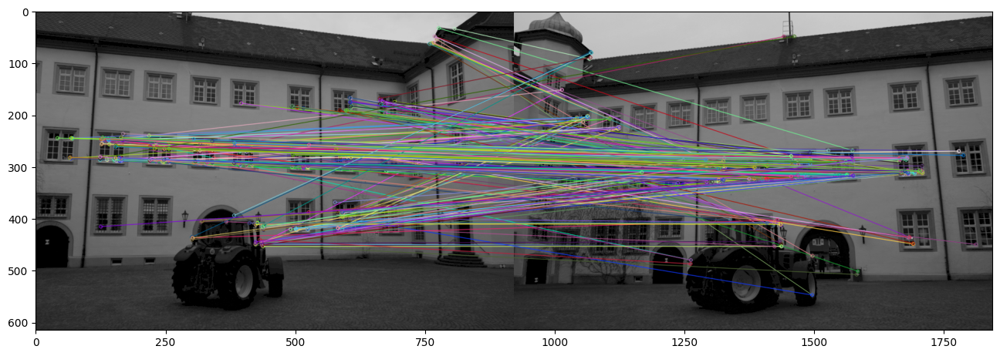

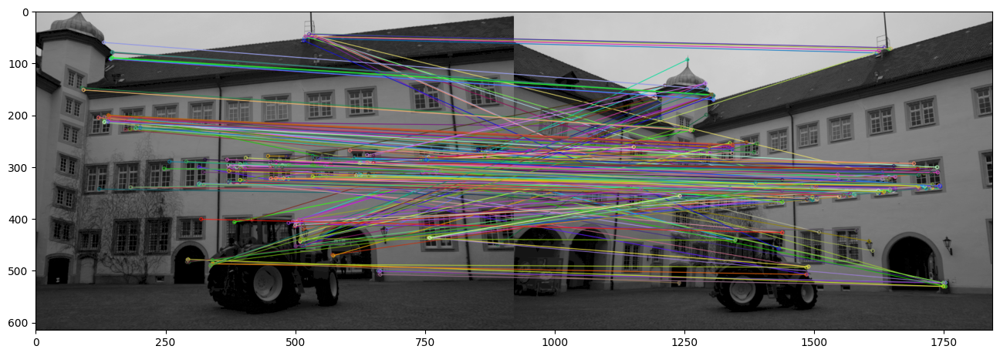

In [2]:
# Read images
img1_castle = cv2.imread('Data/castle_int/0014_s.png', cv2.IMREAD_GRAYSCALE)
img2_castle = cv2.imread('Data/castle_int/0015_s.png', cv2.IMREAD_GRAYSCALE)
img3_castle = cv2.imread('Data/castle_int/0016_s.png', cv2.IMREAD_GRAYSCALE)

kp1, kp2, matches_12 = kp_match(img1_castle, img2_castle, dist_th=0.975)
_, kp3, matches_23 = kp_match(img2_castle, img3_castle, dist_th=0.975)

# Fraw matches
draw_matches(img1_castle, kp1, img2_castle, kp2, matches_12)
draw_matches(img2_castle, kp2, img3_castle, kp3, matches_23)

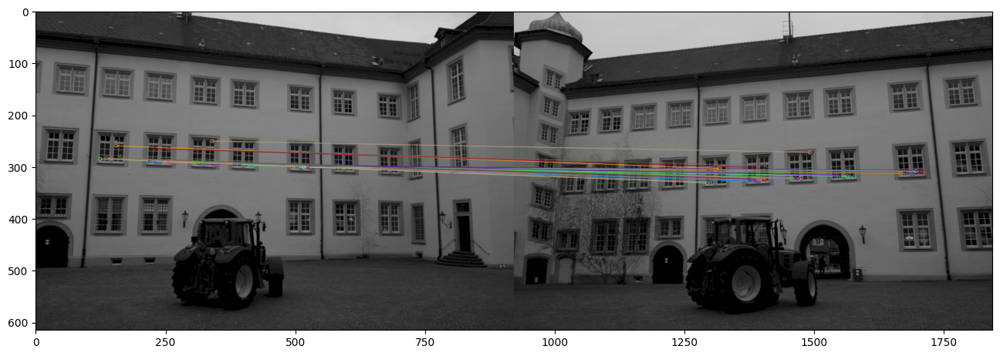

In [3]:
# Compute matches and homography for image pair 1 and 2
P1, P2, H_12, idxs_inlier_matches_12 = get_inliers_homography(kp1, kp2, matches_12)
inlier_matches_12 = itemgetter(*idxs_inlier_matches_12)(matches_12)

draw_matches(img1_castle, kp1, img2_castle, kp2, inlier_matches_12)

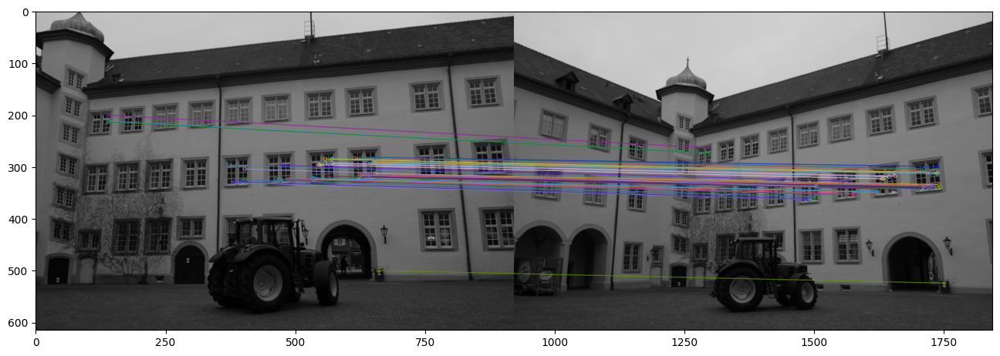

In [10]:
# Compute matches and homography for image pair 2 and 3
P1, P2, H_23, idxs_inlier_matches_23 = get_inliers_homography(kp2, kp3, matches_23)
inlier_matches_23 = itemgetter(*idxs_inlier_matches_23)(matches_23)

draw_matches(img2_castle, kp2, img3_castle, kp3, inlier_matches_23)

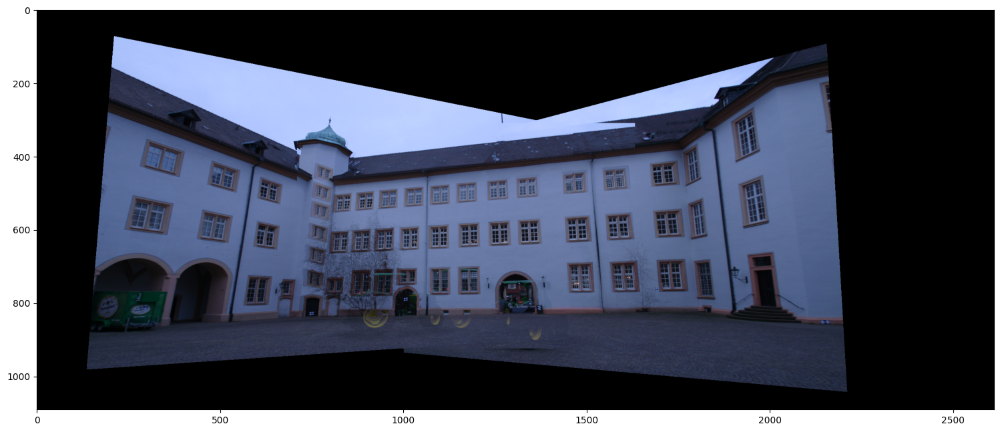

In [13]:
corners = [-710, 1900, -310, 780]

img1_castle = cv2.imread('Data/castle_int/0014_s.png',cv2.IMREAD_COLOR)
img2_castle = cv2.imread('Data/castle_int/0015_s.png',cv2.IMREAD_COLOR)
img3_castle = cv2.imread('Data/castle_int/0016_s.png',cv2.IMREAD_COLOR)

create_mosaic(img1_castle, img2_castle, img3_castle, corners, H_12, H_23, out_filename='mosaic_castle_int.png', store=True)

Still reasonably good, though not as seamless as in `Llanes`. The most noticeable deffect in this mosaic in the `Castle_int` scene is the "phantom" tractor. The reason for the tractor's disappearance is that it does not lie on the same plane in the real 3D world as the facade points. This violates a key assumption for relating points in different 2D images, namely, that points lie on the sample plane.

Despite the tractor's failure, the rest of the scene is more ore less adequately fused, because actually all of the matched keypoints used to set up the correspondances are from the facade.

Notice how we incrased the distance threshold in the ratio test, in order to obtain more initial matches. Still, RANSAC got rid of the spurious matches on the tractor.

<span style='color:Green'> - Compute the mosaic with aerial images set 13 </span>

#### 2.3. Aerial/site13

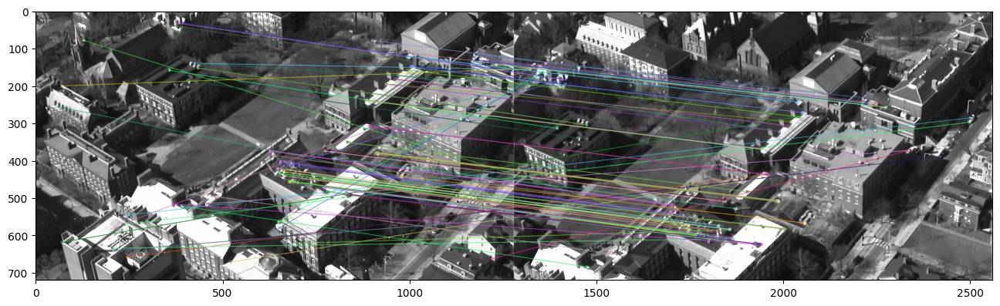

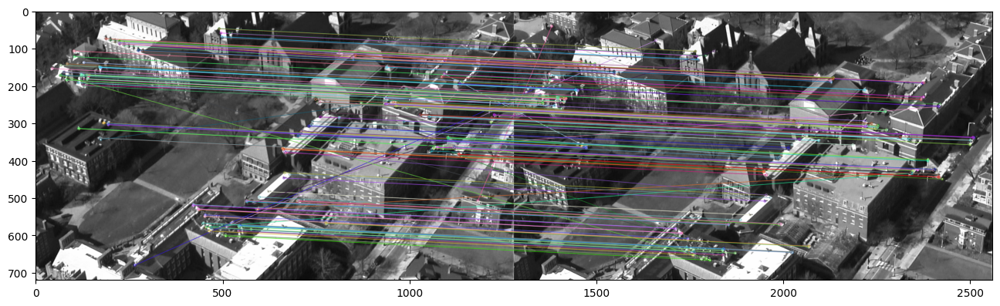

In [14]:
# Read images
img1_aerial = cv2.imread('Data/aerial/site13/frame00000.png', cv2.IMREAD_GRAYSCALE)
img2_aerial = cv2.imread('Data/aerial/site13/frame00002.png', cv2.IMREAD_GRAYSCALE)
img3_aerial = cv2.imread('Data/aerial/site13/frame00003.png', cv2.IMREAD_GRAYSCALE)

kp1, kp2, matches_12 = kp_match(img1_aerial, img2_aerial)
_, kp3, matches_23 = kp_match(img2_aerial, img3_aerial)

# Draw matches
draw_matches(img1_aerial, kp1, img2_aerial, kp2, matches_12)
draw_matches(img2_aerial, kp2, img3_aerial, kp3, matches_23)

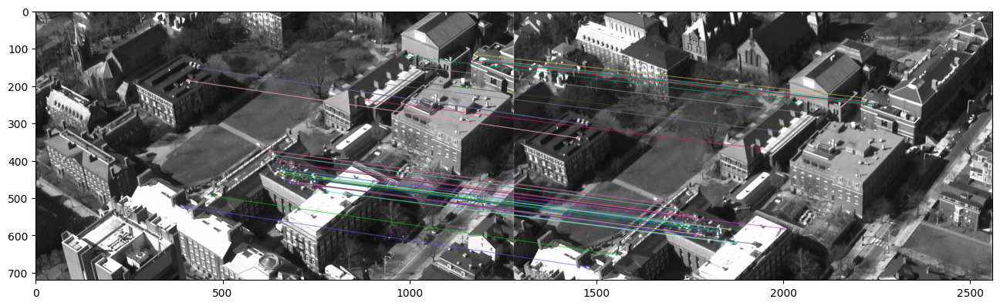

In [15]:
# Compute matches and homography for image pair 1 and 2
P1, P2, H_12, idxs_inlier_matches_12 = get_inliers_homography(kp1, kp2, matches_12)
inlier_matches_12 = itemgetter(*idxs_inlier_matches_12)(matches_12)

draw_matches(img1_aerial, kp1, img2_aerial, kp2, inlier_matches_12)

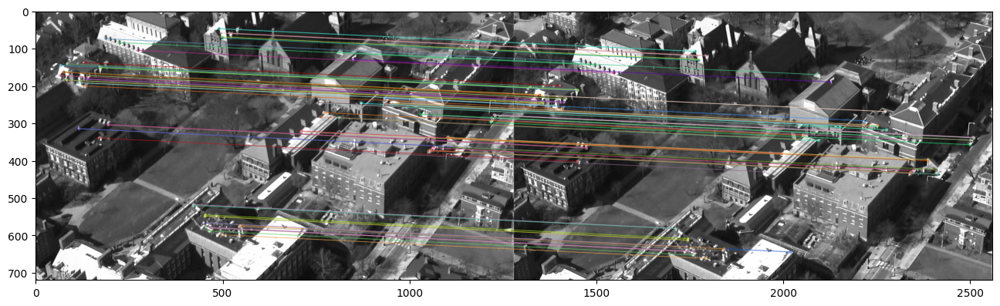

In [16]:
# Compute matches and homography for image pair 2 and 3
points2, points3, H_23, idxs_inlier_matches_23 = get_inliers_homography(kp2, kp3, matches_23)
inlier_matches_23 = itemgetter(*idxs_inlier_matches_23)(matches_23)

draw_matches(img2_aerial, kp2, img3_aerial, kp3, inlier_matches_23)

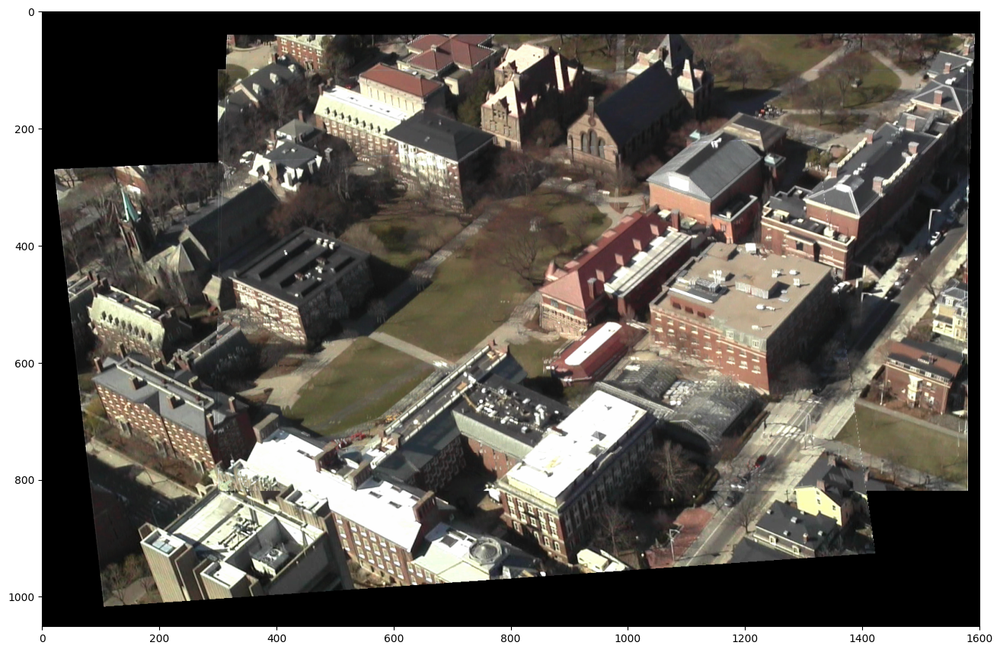

In [18]:
corners = [-300, 1300, -100, 950]  # corners of the canvas where the mosaic will be created

img1_aerial = cv2.imread('Data/aerial/site13/frame00000.png', cv2.IMREAD_COLOR)
img2_aerial = cv2.imread('Data/aerial/site13/frame00002.png', cv2.IMREAD_COLOR)
img3_aerial = cv2.imread('Data/aerial/site13/frame00003.png', cv2.IMREAD_COLOR)

create_mosaic(img1_aerial, img2_aerial, img3_aerial, corners, H_12, H_23, out_filename='mosaic_aerial_site13.png', store=True)

As in the first scene, this three pictures from `aerial/site13` are taken from a distance. Moreover, this time the picture is taken from a very high angle, which strengthens the assumption that the photographed points lie on the same plane (to see why, consider that the vertical lines would like exactly like dots when viewed exactly from above: their apparent length is the length multiplied by the cosine of the elevation angle). Despite the buildings having a certain height, the effect of the angle and the fact that they are not very tall does not hinder the planar assumption.

<span style='color:Green'> - Compute the mosaic with aerial images set 22 </span>

#### 2.4. Aerial/site22

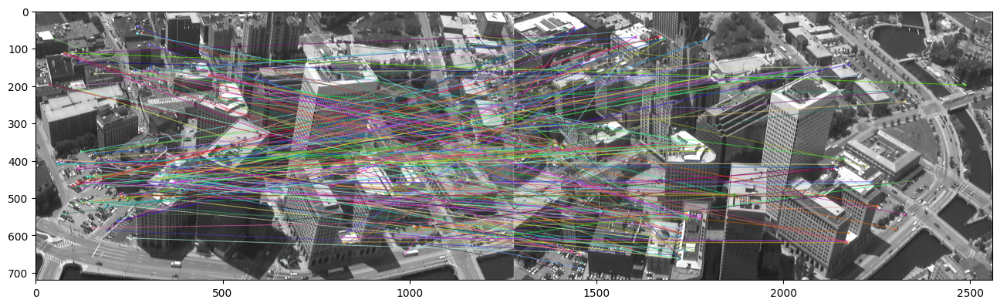

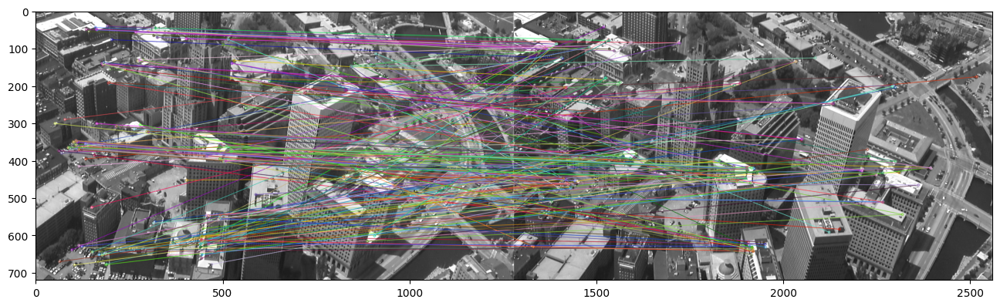

In [19]:
# Read images
img1_22 = cv2.imread('Data/aerial/site22/frame_00001.tif',cv2.IMREAD_GRAYSCALE)
img2_22 = cv2.imread('Data/aerial/site22/frame_00018.tif',cv2.IMREAD_GRAYSCALE)
img3_22 = cv2.imread('Data/aerial/site22/frame_00030.tif',cv2.IMREAD_GRAYSCALE)

kp1, kp2, matches_12 = kp_match(img1_22, img2_22, dist_th=0.92)
_, kp3, matches_23 = kp_match(img2_22, img3_22, dist_th=0.92)

# Draw matches
draw_matches(img1_22, kp1, img2_22, kp2, matches_12)
draw_matches(img2_22, kp2, img3_22, kp3, matches_23)

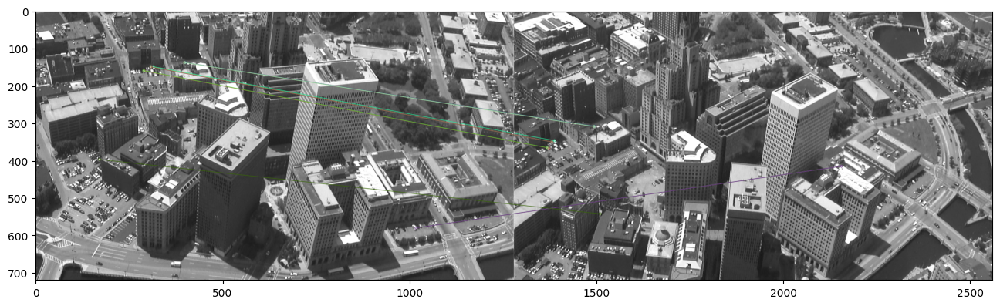

In [20]:
# Compute matches and homography for image pair 1 and 2
P1, P2, H_12, idxs_inlier_matches_12 = get_inliers_homography(kp1, kp2, matches_12)
inlier_matches_12 = itemgetter(*idxs_inlier_matches_12)(matches_12)

draw_matches(img1_22, kp1, img2_22, kp2, inlier_matches_12)

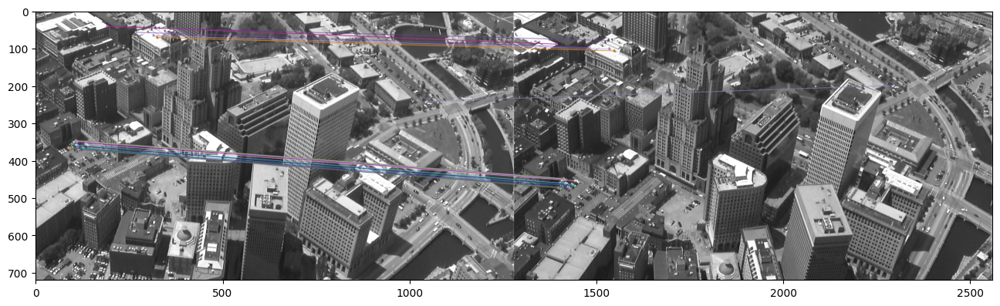

In [21]:
# Compute matches and homography for image pair 2 and 3
P2, P3, H_23, idxs_inlier_matches_23 = get_inliers_homography(kp2, kp3, matches_23)
inlier_matches_23 = itemgetter(*idxs_inlier_matches_23)(matches_23)

draw_matches(img2_22, kp2, img3_22, kp3, inlier_matches_23)

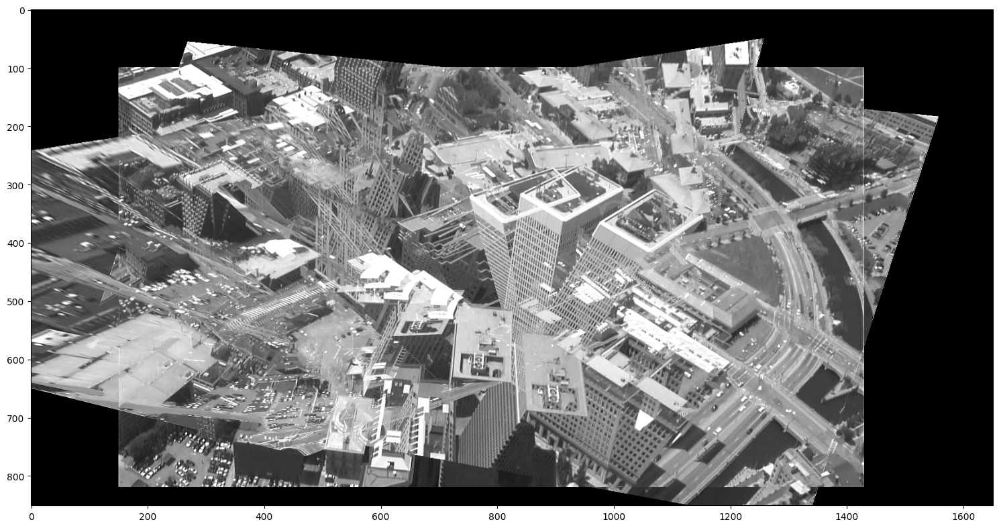

In [22]:
corners = [-150, 1500, -100, 750] # corners of the canvas where the mosaic will be created

img1_22 = cv2.imread('Data/aerial/site22/frame_00001.tif',cv2.IMREAD_COLOR)
img2_22 = cv2.imread('Data/aerial/site22/frame_00018.tif',cv2.IMREAD_COLOR)
img3_22 = cv2.imread('Data/aerial/site22/frame_00030.tif',cv2.IMREAD_COLOR)

create_mosaic(img1_22, img2_22, img3_22, corners, H_12, H_23, out_filename='mosaic_aerial_site22.png', store=True)

In scene `Aerial/site22`, the DLT algorithm has obviously failed to fuse the views into a single panorama. This is due to the fact that the planar assumption is violated. The scene contains buldings of very different heights: regular buildings and skyscrappers. The geometry of the scene is not planar, and thus different views of it cannot be related by a homography. In addition to that, the small number of correspondences is also a cause of this failure form DLT to compute the homography (after all, since the points are not coplanar, viewing them from different angles leads to some of them being occluded or looking much differently, so it is harder to match them).

<span style='color:Green'> - In the report, comment the results in every of the four cases: hypothetise why it works or does not work </span>

## **3. Refinement of the estimated homography with the Gold Standard algorithm**

In order to refine the previous estimated homography we can minimize the geometric error with the Levenberg-Marquardt algorithm. For that we will call the function 'least_squares' with the proper input arguments that you have to complete. First, it is recommended to read the documentation of that function:

https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.least_squares.html

Notice that the first input is a function that only provides the vector of the residuals. The algorithm constructs the cost function as a sum of squares of the residuals. In our case the function is called 'geometric_error_terms' and you need to complete it.

More precisely, the tasks to perform are:

<span style='color:Green'> - Complete the function 'geometric_error_terms'. </span>

We want to refine the previous estimated homography from `aerial/site22` images.
We need to compute again the keypoints and estimate the homographies.

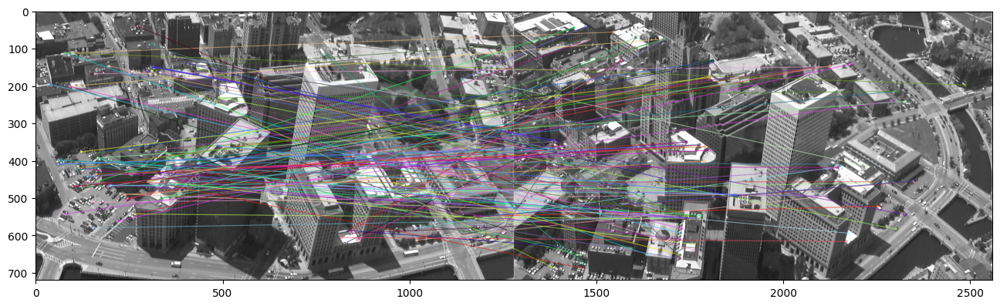

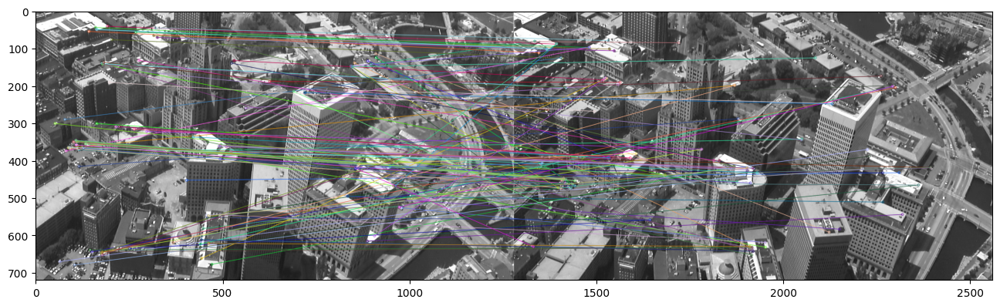

In [ ]:
# Read images
img1_22 = cv2.imread('Data/aerial/site22/frame_00001.tif',cv2.IMREAD_GRAYSCALE)
img2_22 = cv2.imread('Data/aerial/site22/frame_00018.tif',cv2.IMREAD_GRAYSCALE)
img3_22 = cv2.imread('Data/aerial/site22/frame_00030.tif',cv2.IMREAD_GRAYSCALE)

kp1, kp2, matches_12 = kp_match(img1_22, img2_22, dist_th=0.92)
_, kp3, matches_23 = kp_match(img2_22, img3_22, dist_th=0.92)

# Draw matches
draw_matches(img1_22, kp1, img2_22, kp2, matches_12)
draw_matches(img2_22, kp2, img3_22, kp3, matches_23)

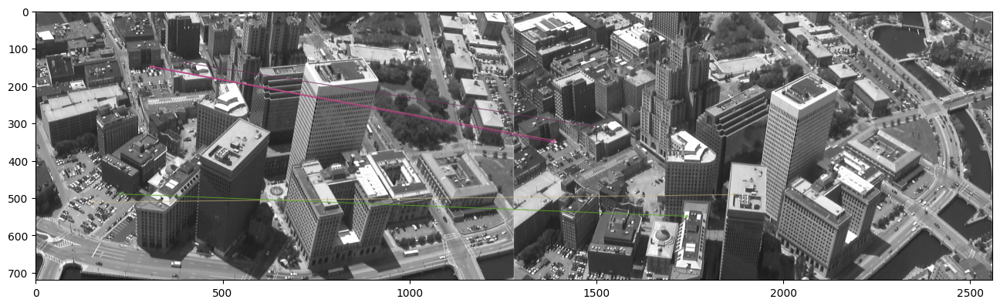

In [ ]:
# Compute matches and homography for image pair 1 and 2
P1, P2, H_12, idxs_inlier_matches_12 = get_inliers_homography(kp1, kp2, matches_12)
inlier_matches_12 = itemgetter(*idxs_inlier_matches_12)(matches_12)

draw_matches(img1_22, kp1, img2_22, kp2, inlier_matches_12)

<span style='color:Green'> - Complete the code before calling function 'geometric_error_terms' in order to create the proper input of variables, 'variables0', to pass to the function. </span>

In [ ]:
variables, points, P1_proj = get_geom_error_inputs(P1, P2, H_12, idxs_inlier_matches_12)
result = least_squares(geometric_error_terms, variables, method='lm', args=([points]))

<span style='color:Green'> - Extract the refined homogaphy and the refined keypoint locations from the output, 'result', of function 'geometric_error_terms'.  </span>

In [ ]:
H_12_refined, points1_refined = get_result_solution_ls(result)

<span style='color:Green'> - To better compare the two homographies (refined and non refined) compute and print the geometric error before and after the refinement. </span>

In [ ]:
error_before_refinement = compute_geometric_error(points, H_12, P1_proj)
error_after_refinement = compute_geometric_error(points, H_12_refined, points1_refined)

print('Geometric error before refinement: {:.2f}'.format(error_before_refinement))
print('Geometric error after refinement: {:.2f}'.format(error_after_refinement))

Geometric error before refinement: 12966250.12
Geometric error after refinement: 1.39


<span style='color:Green'> - Refine the homography 23 with the Gold Standard algorithm and visualize the differences in the keypoint locations. </span>

We already refined homography 12 (its `H_12_refined`) and the refined keypoints locations from the output result of geometric error function in previous questions.

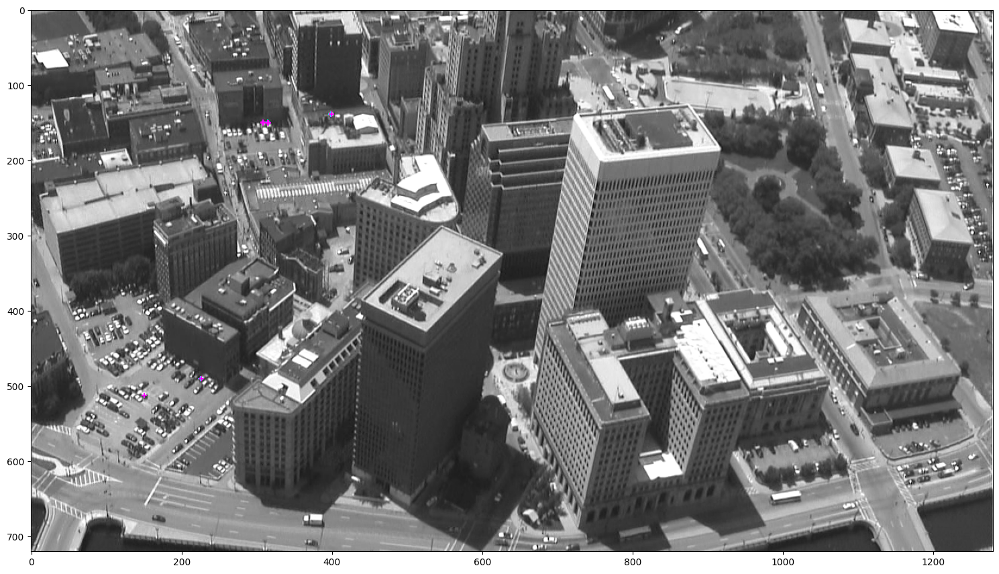

In [ ]:
points1_inliers = P1[:,idxs_inlier_matches_12]
show_points_refined(img1_22, points1_inliers, points1_refined)

Aerial image with the ground truth (blue crosses) and predicted/refined keypoints (purples crosses). We can see that they are practically overlapping.

We do the same with homography 23:

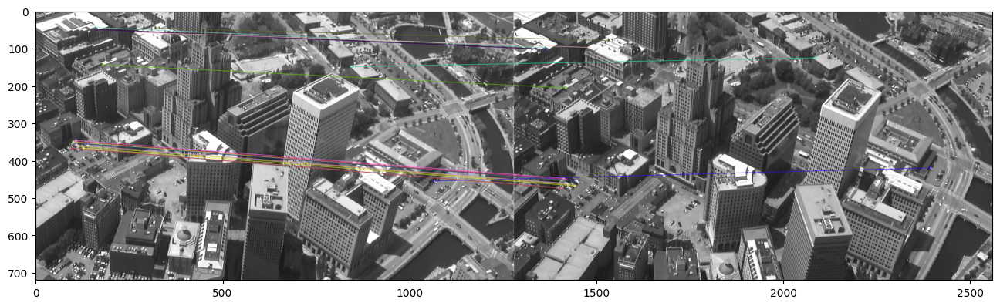

In [ ]:
# Compute matches and homography for image pair 2 and 3
P2, P3, H_23, idxs_inlier_matches_23 = get_inliers_homography(kp2, kp3, matches_23)
inlier_matches_23 = itemgetter(*idxs_inlier_matches_23)(matches_23)

draw_matches(img2_22, kp2, img3_22, kp3, inlier_matches_23)

Geometric error before refinement: 5015221.65
Geometric error after refinement: 5.51


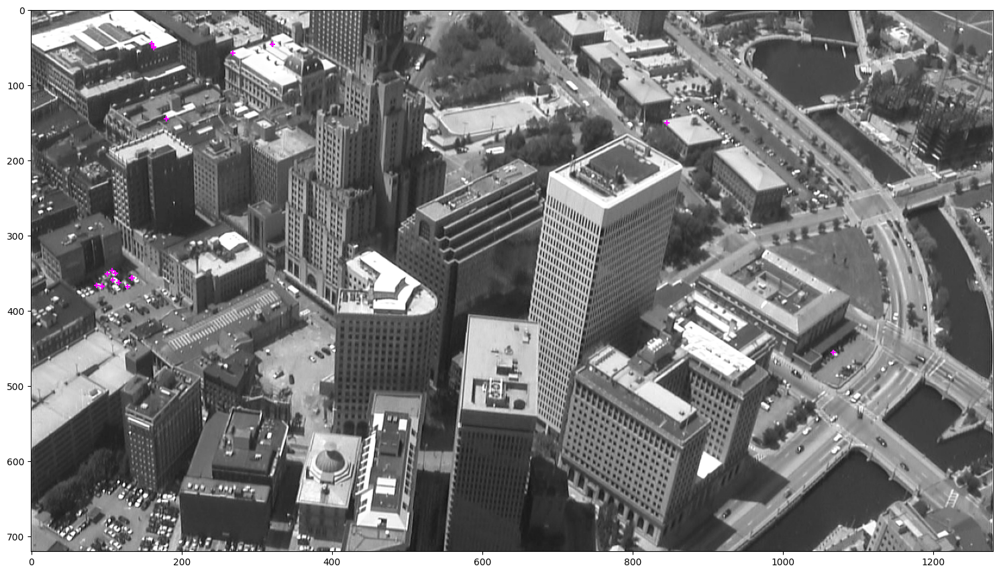

In [ ]:
variables, points, P2_proj = get_geom_error_inputs(P2, P3, H_23, idxs_inlier_matches_23)
result = least_squares(geometric_error_terms, variables, method='lm', args=([points]))

H_23_refined, points2_refined = get_result_solution_ls(result)

error_before_refinement = compute_geometric_error(points, H_23, P2_proj)
error_after_refinement = compute_geometric_error(points, H_23_refined, points2_refined)

print('Geometric error before refinement: {:.2f}'.format(error_before_refinement))
print('Geometric error after refinement: {:.2f}'.format(error_after_refinement))

points2_inliers = P2[:,idxs_inlier_matches_23]
show_points_refined(img2_22, points2_inliers, points2_inliers)

<span style='color:Green'> - Build mosaic with the refined homographies. </span>

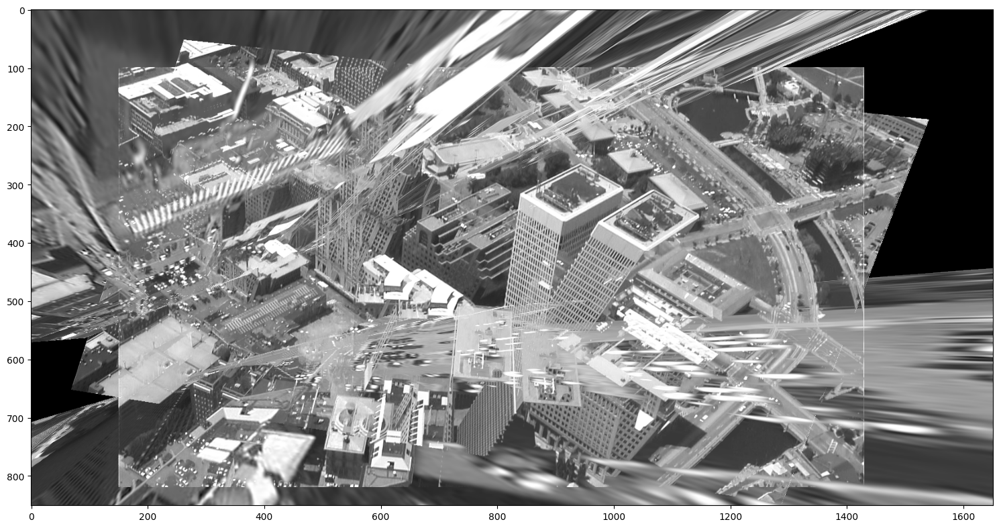

In [ ]:
corners = [-150, 1500, -100, 750] # corners of the canvas where the mosaic will be created

img1_22_c = cv2.imread('Data/aerial/site22/frame_00001.tif',cv2.IMREAD_COLOR)
img2_22_c = cv2.imread('Data/aerial/site22/frame_00018.tif',cv2.IMREAD_COLOR)
img3_22_c = cv2.imread('Data/aerial/site22/frame_00030.tif',cv2.IMREAD_COLOR)

create_mosaic(img1_22_c, img2_22_c, img3_22_c, corners, H_12_refined, H_23_refined, out_filename='mosaic_aerial_site22_refined.png', store=True)

### Try refinement with Castle_int

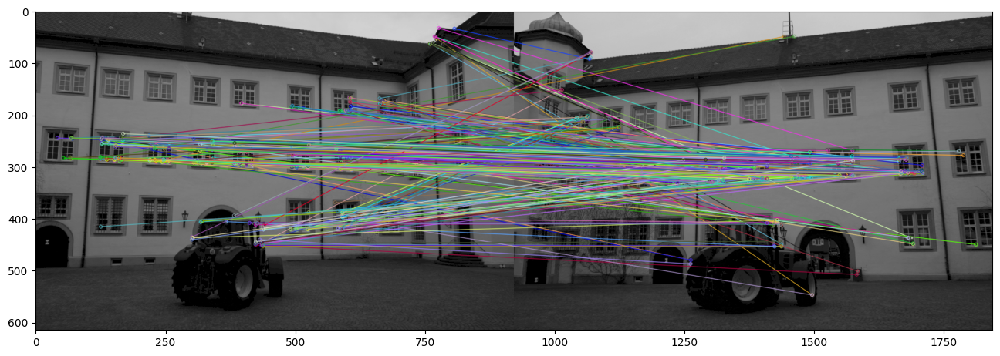

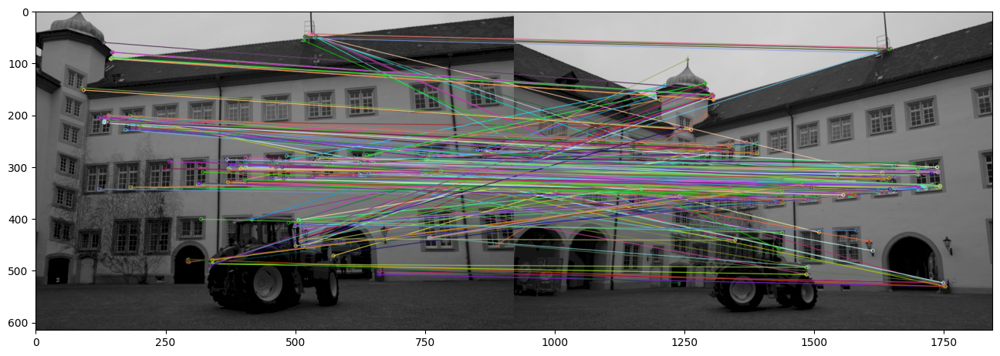

In [ ]:
# Read images
img1_castle = cv2.imread('Data/castle_int/0014_s.png', cv2.IMREAD_GRAYSCALE)
img2_castle = cv2.imread('Data/castle_int/0015_s.png', cv2.IMREAD_GRAYSCALE)
img3_castle = cv2.imread('Data/castle_int/0016_s.png', cv2.IMREAD_GRAYSCALE)

kp1, kp2, matches_12 = kp_match(img1_castle, img2_castle, dist_th=0.975)
_, kp3, matches_23 = kp_match(img2_castle, img3_castle, dist_th=0.975)

# Fraw matches
draw_matches(img1_castle, kp1, img2_castle, kp2, matches_12)
draw_matches(img2_castle, kp2, img3_castle, kp3, matches_23)

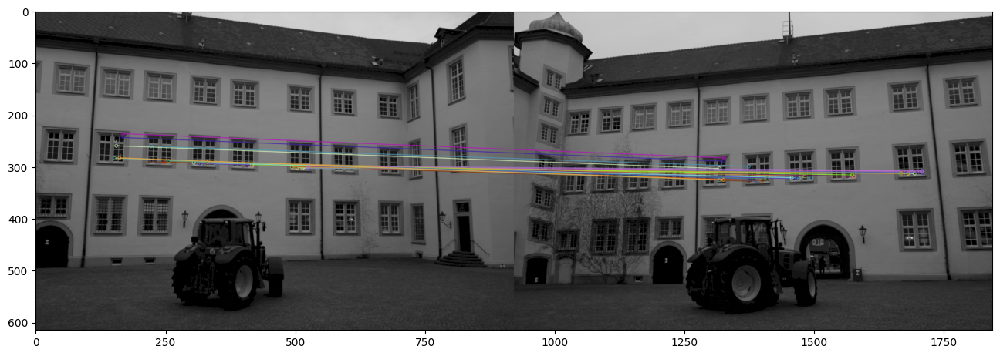

In [ ]:
# Compute matches and homography for image pair 1 and 2
P1, P2, H_12, idxs_inlier_matches_12 = get_inliers_homography(kp1, kp2, matches_12)
inlier_matches_12 = itemgetter(*idxs_inlier_matches_12)(matches_12)

draw_matches(img1_castle, kp1, img2_castle, kp2, inlier_matches_12)

Geometric error before refinement: 58882687.92
Geometric error after refinement: 8.53


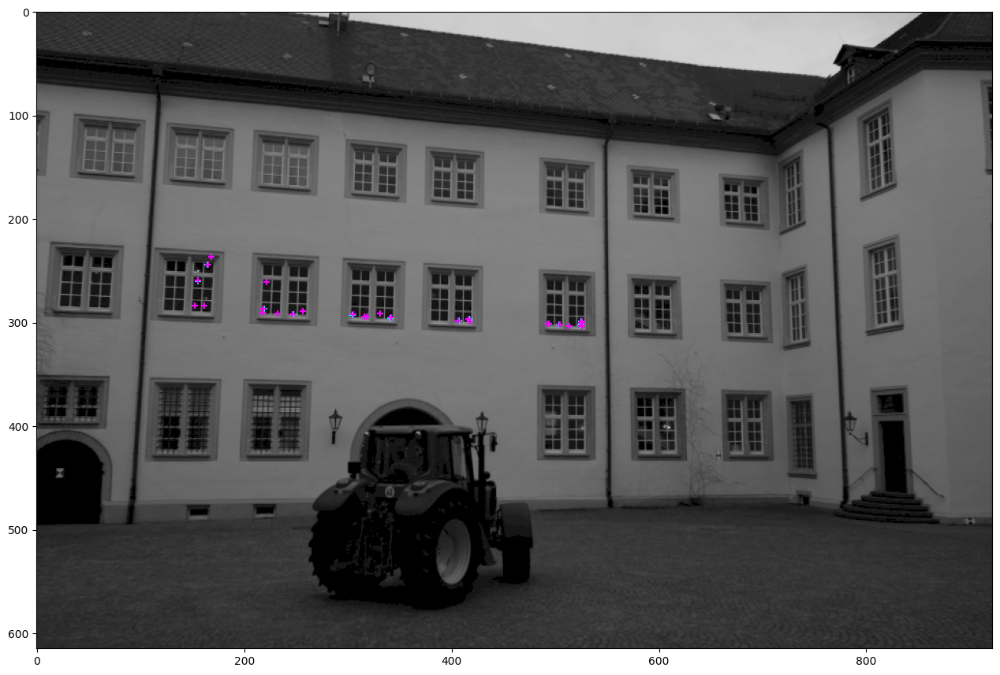

In [ ]:
variables, points, P1_proj = get_geom_error_inputs(P1, P2, H_12, idxs_inlier_matches_12)
result = least_squares(geometric_error_terms, variables, method='lm', args=([points]))

H_12_refined, points1_refined = get_result_solution_ls(result)

error_before_refinement = compute_geometric_error(points, H_12, P1_proj)
error_after_refinement = compute_geometric_error(points, H_12_refined, points1_refined)

print('Geometric error before refinement: {:.2f}'.format(error_before_refinement))
print('Geometric error after refinement: {:.2f}'.format(error_after_refinement))

points1_inliers = P1[:,idxs_inlier_matches_12]
show_points_refined(img1_castle, points1_inliers, points1_refined)

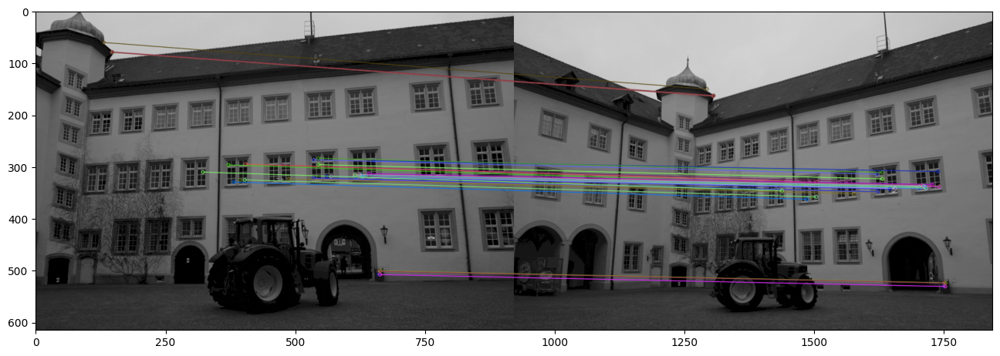

In [ ]:
# Compute matches and homography for image pair 2 and 3
P2, P3, H_23, idxs_inlier_matches_23 = get_inliers_homography(kp2, kp3, matches_23)
inlier_matches_23 = itemgetter(*idxs_inlier_matches_23)(matches_23)

draw_matches(img2_castle, kp2, img3_castle, kp3, inlier_matches_23)

Geometric error before refinement: 176516788.08
Geometric error after refinement: 9.85


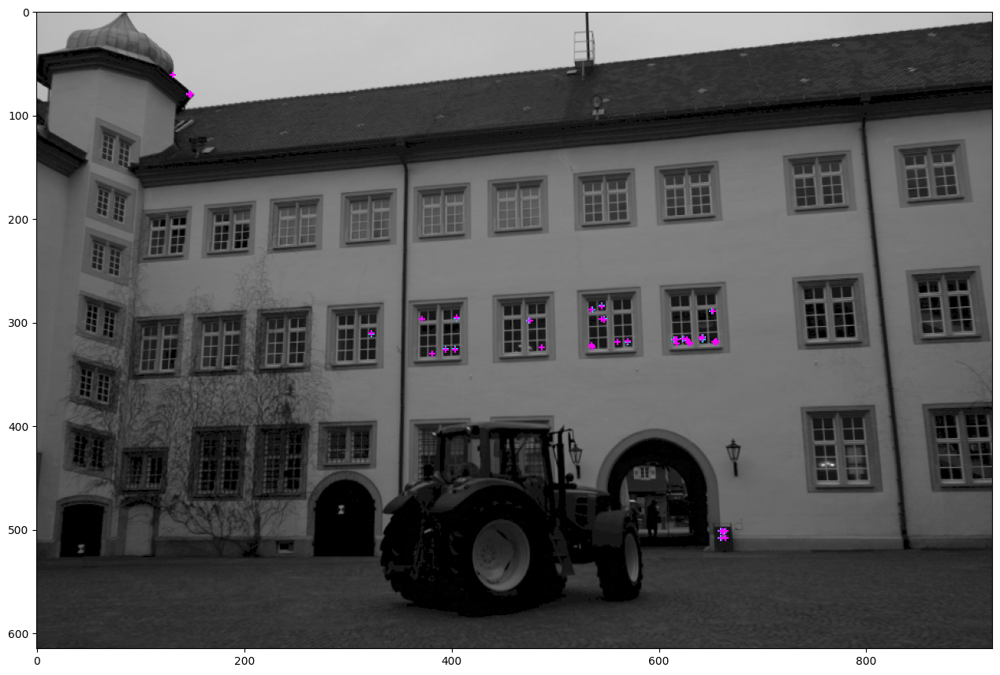

In [ ]:
variables, points, P2_proj = get_geom_error_inputs(P2, P3, H_23, idxs_inlier_matches_23)
result = least_squares(geometric_error_terms, variables, method='lm', args=([points]))

H_23_refined, points2_refined = get_result_solution_ls(result)

error_before_refinement = compute_geometric_error(points, H_23, P2_proj)
error_after_refinement = compute_geometric_error(points, H_23_refined, points2_refined)

print('Geometric error before refinement: {:.2f}'.format(error_before_refinement))
print('Geometric error after refinement: {:.2f}'.format(error_after_refinement))

points2_inliers = P2[:,idxs_inlier_matches_23]
show_points_refined(img2_castle, points2_inliers, points2_refined)

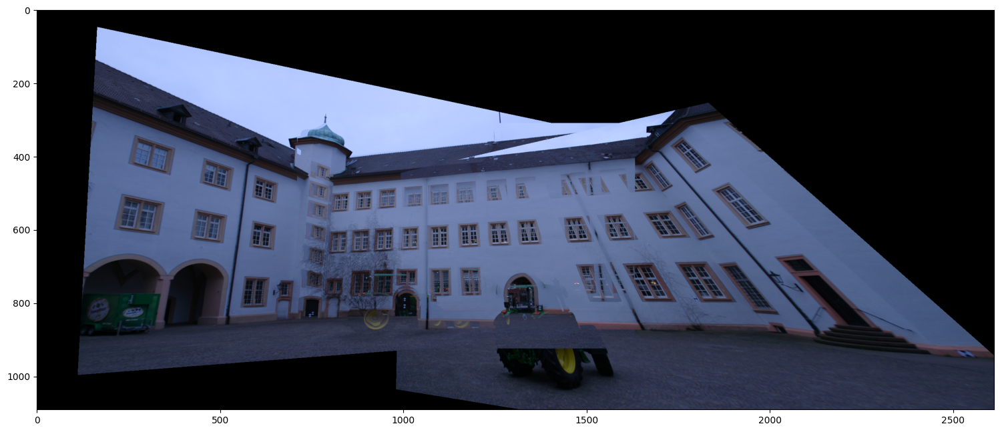

In [ ]:
corners = [-710, 1900, -310, 780]

img1_castle_c = cv2.imread('Data/castle_int/0014_s.png',cv2.IMREAD_COLOR)
img2_castle_c = cv2.imread('Data/castle_int/0015_s.png',cv2.IMREAD_COLOR)
img3_castle_c = cv2.imread('Data/castle_int/0016_s.png',cv2.IMREAD_COLOR)

create_mosaic(img1_castle_c, img2_castle_c, img3_castle_c, corners, H_12_refined, H_23_refined, out_filename='mosaic_castle_int_refined.png', store=True)

## **4. OPTIONAL. Application: Calibration with a planar pattern and augmented reality**

As we have seen in class, we can calibrate a camera with a planar pattern with Zhang's algorithm. A key aspect of this algorithm is the estimation of a homography that relates a pair of images, in particular, the template image and an image of it taken with the camera we want to calibrate. Once the camera is calibrated and we have recovered the relative pose between the camera and the planar pattern we can properly insert a virtual object on top of the flat pattern in a way that it is consistent, in a perspective sense, with rest of the scene.

### **4.1 Camera calibration**

The following code calibrates a camera using N (where N greater or equal than three) views of the planar pattern. Most of the code is provided but there are parts you need to complete. These parts are indicated in green before the corresponding cell code.


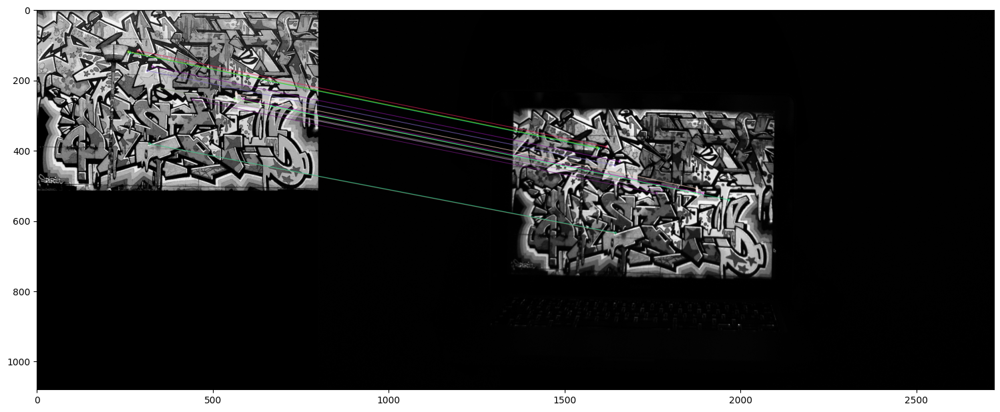

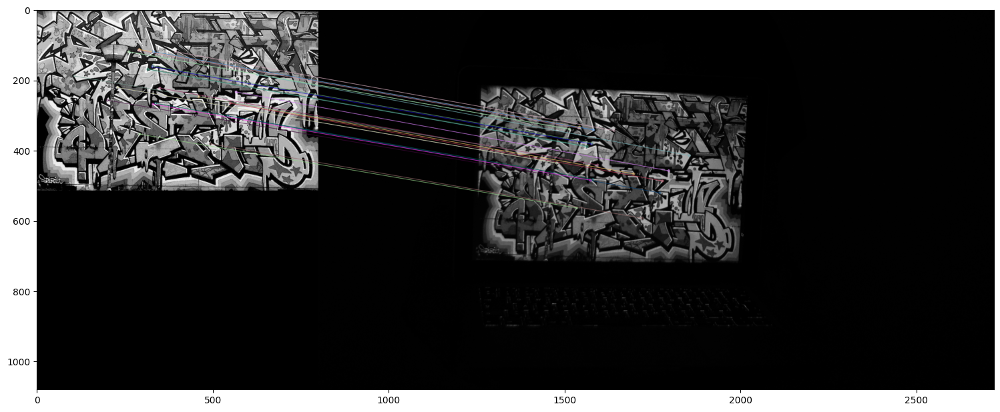

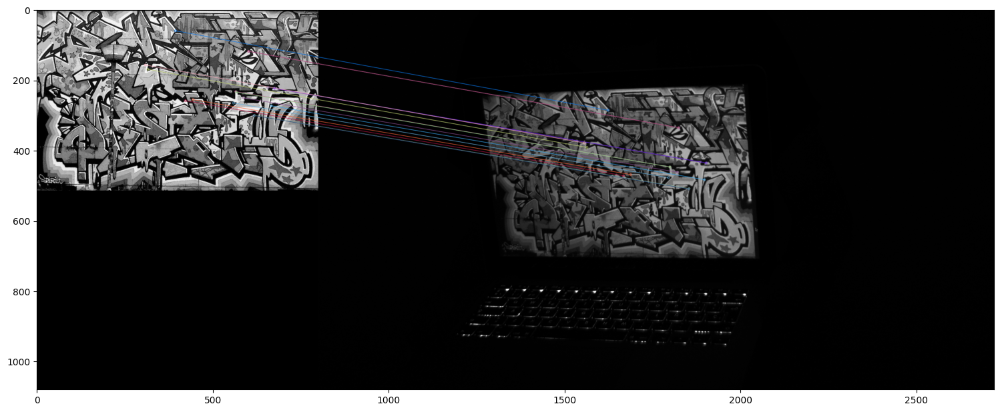

In [3]:
# Read template image and calibration images
template = cv2.imread('Data/calib/template.jpg',cv2.IMREAD_GRAYSCALE)
images = []
N = 3 # 3, 4, or 5
for i in range(1,N+1):
    m = cv2.imread("Data/calib/graffiti{0}.tif".format(i),cv2.IMREAD_GRAYSCALE)
    images.append(m)

# Initiate ORB detector
orb = cv2.ORB_create()
# find the keypoints and descriptors with ORB
kpt, dest = orb.detectAndCompute(template,None)
kpi, desi = [], []
for m in images:
    kp, des = orb.detectAndCompute(m,None)
    kpi.append(kp)
    desi.append(des)


# Keypoint matching and homography estimation
bf = cv2.BFMatcher()
H = []
for i in range(N):
    matches = bf.knnMatch(dest,desi[i],k=2)
    # Apply ratio test
    good_matches = []
    for m,n in matches:
        if m.distance < 0.75*n.distance:
            good_matches.append([m])

    # Fit homography and remove outliers
    points1 = []
    points2 = []
    for m in good_matches:
        points1.append([kpt[m[0].queryIdx].pt[0], kpt[m[0].queryIdx].pt[1], 1])
        points2.append([kpi[i][m[0].trainIdx].pt[0], kpi[i][m[0].trainIdx].pt[1], 1])

    points1 = np.asarray(points1)
    points1 = points1.T
    points2 = np.asarray(points2)
    points2 = points2.T

    Hi, indices_inlier_matches = Ransac_DLT_homography(points1, points2, 3, 1000)
    H.append(Hi)

    # Show inlier matches
    inlier_matches = itemgetter(*indices_inlier_matches)(good_matches)
    img_12 = cv2.drawMatchesKnn(template,kpt,images[i],kpi[i],inlier_matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img_12)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()


<span style='color:Green'> - Complete the code that computes the Image of the Absolute Conic. </span>

In [5]:
def set_Vij(hi, hj):
    V01 = np.array(
        [
            hi[0] * hj[0],
            hi[0] * hj[1] + hi[1] * hj[0],
            hi[0] * hj[2] + hi[2] * hj[0],
            hi[1] * hj[1],
            hi[1] * hj[2] + hi[2] * hj[1],
            hi[2] * hj[2]
        ]
    )
    return V01

def set_constraint(V01, V00, V11):
    return np.vstack((V01, V00 - V11))

def set_V(H):
    V_all = []
    for Hi in H:
        h0 = Hi[:, 0]
        h1 = Hi[:, 1]
        V01 = set_Vij(h0, h1)
        V00 = set_Vij(h0, h0)
        V11 = set_Vij(h1, h1)
        V = set_constraint(V01, V00, V11)
        V_all.append(V)
    V_all = np.vstack(V_all)
    return V_all

V = set_V(H)

In [6]:
_, _, Vh = np.linalg.svd(V)
Omega = Vh[-1, :]

omega = np.zeros(3)

# place Omega in symmetric matrix
omega = np.array(
    [
        [Omega[0], Omega[1], Omega[2]],
        [Omega[1], Omega[3], Omega[4]],
        [Omega[2], Omega[4], Omega[5]],
    ]
)

# Image of the Absolute Conic
omega

array([[ 1.07263518e-07, -1.10158434e-09, -7.68350199e-05],
       [-1.10158434e-09,  1.07476109e-07, -6.86927787e-05],
       [-7.68350199e-05, -6.86927787e-05,  9.99999995e-01]])

<span style='color:Green'> - Complete the code that computes the matrix of internal parameters K. </span>

Note: there is a linalg.cholesky function both in numpy and scipy, you have to read the documentation of both and find out which is the proper one to use here.

`numpy.linalg.cholesky` returns a lower-triangular matrix, whereas `scipy.linalg.cholesky` returns an upper-triangular one. We know the matrix `K` of extrinsics is upper-triangular, so we choose `scipy`.

In [7]:
# Decompose omega with Cholesky decomposition
import scipy
Kinv = scipy.linalg.cholesky(omega)
K = np.linalg.inv(Kinv)

print(f'K:\n{K}')

K:
[[3.05333167e+03 3.13279955e+01 7.62051006e+02]
 [0.00000000e+00 3.05047093e+03 6.81514191e+02]
 [0.00000000e+00 0.00000000e+00 1.05407048e+00]]


<span style='color:Green'> - In the report, make some comments related to the obtained internal camera parameters and also comment their relation to the image size. </span>

<span style='color:Green'> - Complete the calculation of r1, r2, and ti in the code below. </span>

In [8]:
# Compute camera position and orientation
import math
R = []
t = []
P = []

for i in range(N):
    # compute r1, r2, and t{i}
    h = H[i]
    r1 = Kinv @ h[:,0]
    r2 = Kinv @ h[:,1]
    ti = Kinv @ h[:,2]

    # Solve the scale ambiguity by forcing r1 and r2 to be unit vectors.
    s = math.sqrt(np.linalg.norm(r1) * np.linalg.norm(r2)) * np.sign(ti[2])
    r1 = r1 / s
    r2 = r2 / s
    ti = ti / s
    t.append(ti)
    Ri = np.array([r1, r2, np.cross(r1,r2)])
    Ri = Ri.T

    # Ensure R is a rotation matrix
    U, d, Vt = np.linalg.svd(Ri)
    Ri = U @ np.identity(3) @ Vt
    R.append(Ri)

    # Pi = K * [Ri ti]
    A = np.zeros((3,4))
    A[:3,:3] = Ri
    A[:,3] = ti
    Pi = K @ A
    P.append(Pi)

The following code (no need to be completed) draws the planar pattern and the N camera locations (position and orientation).

<span style='color:Green'> - Take a look to the provided code for that and in the report explain how the optical center is computed. </span>

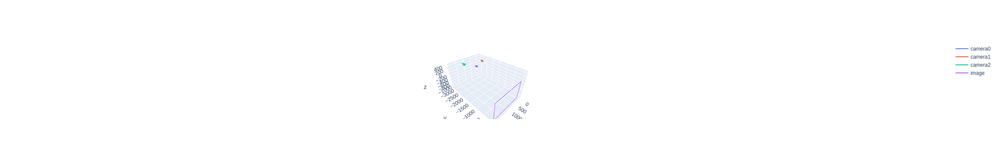

In [9]:
import plotly.graph_objects as go
from utils import plot_camera, plot_image_origin

ny, nx = images[0].shape

fig = go.Figure()
for i in range(N):
    plot_camera(P[i], nx, ny, fig, "camera{0}".format(i))

plot_image_origin(nx, ny, fig, "image")

fig.show()

Alternatively, we can draw a fixed camera and N planar patterns at different relative poses with respect to the camera.

<span style='color:Green'> -Complete the function ' plot_image_Rt' in order to achieve that. Note: it may be useful to look at function 'plot_image_origin' in utils.py</span>

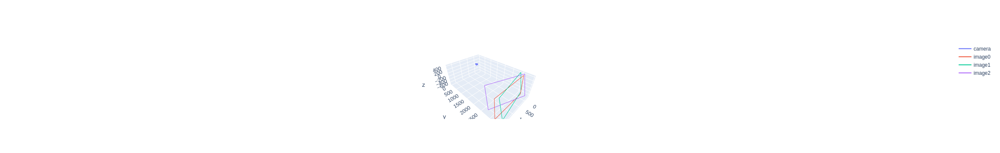

In [10]:
def plot_image_Rt(R,t,w, h, fig, legend):
    # Rotate and translate the corners of each image with the corresponding extrinsics R, t
    Rt = np.column_stack([R, t])
    p1 = Rt @ np.array([0, 0, 0, 1])
    p2 = Rt @ np.array([w, 0, 0, 1])
    p3 = Rt @ np.array([w, h, 0, 1])
    p4 = Rt @ np.array([0, h, 0, 1])

    x = np.array([p1[0], p2[0], p3[0], p4[0], p1[0]])
    y = np.array([p1[1], p2[1], p3[1], p4[1], p1[1]])
    z = np.array([p1[2], p2[2], p3[2], p4[2], p1[2]])

    fig.add_trace(go.Scatter3d(x=x, y=z, z=-y, mode='lines',name=legend))
    
    return

fig = go.Figure()
A = np.zeros((3,4))
A[0,0]=A[1,1]=A[2,2]=1

plot_camera(K@A, nx, ny, fig, "camera")
for i in range(N):
    plot_image_Rt(R[i], t[i], nx, ny, fig, "image{0}".format(i))

fig.show()

### **4.2 Augmented reality**

The following code (no need to be completed) draws a simple 3D virtual object (a cube) on top of the flat pattern.

<span style='color:Green'> - Analyse the provided code and in the report explain how the virtual object is inserted in the image and why the camera view needs to be calibrated. </span>

[[ 300.   500.   500.   300.   300.   300.   500.   500.   300.   300.
   300.   500.   500.   300.   300.   300.   500.   500.   300.   300. ]
 [ 157.5  157.5  357.5  357.5  157.5  157.5  157.5  357.5  357.5  157.5
   157.5  157.5  157.5  157.5  157.5  357.5  357.5  357.5  357.5  357.5]
 [-200.  -200.  -200.  -200.  -200.     0.     0.     0.     0.     0.
  -200.  -200.     0.     0.  -200.  -200.  -200.     0.     0.  -200. ]]


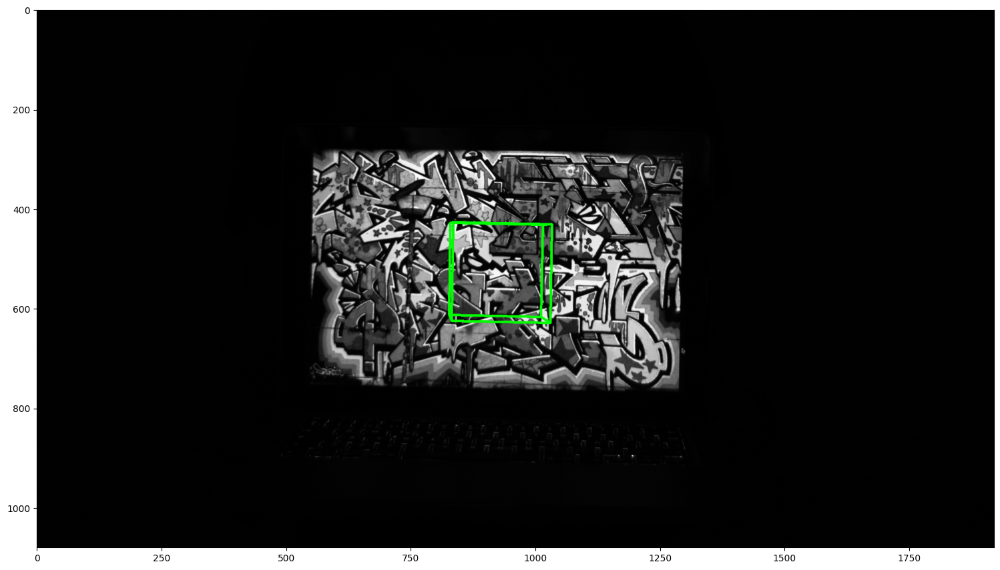

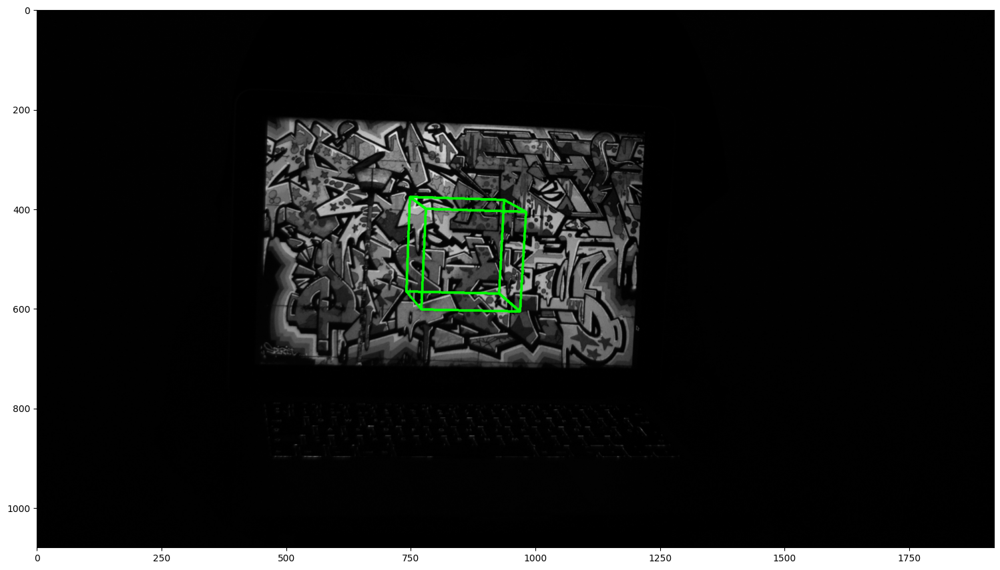

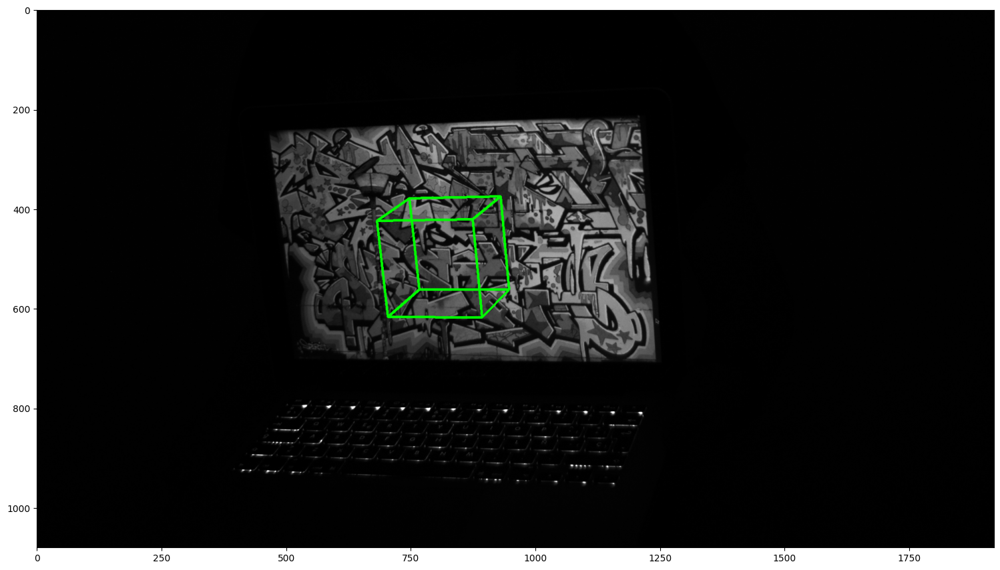

In [15]:
Th, Tw = template.shape
cube_corners = np.array([[0, 0, 0], [1, 0, 0], [1, 1, 0], [0, 1, 0], [0, 0, 0], [0, 0, 1], [1, 0, 1], [1, 1, 1], [0, 1, 1], [0, 0, 1], [0, 0, 0], [1, 0, 0], [1, 0, 1], [0, 0, 1], [0, 0, 0], [0, 1, 0], [1, 1, 0], [1, 1, 1], [0, 1, 1], [0, 1, 0]])

import numpy.matlib
offset = np.array([Tw/2, Th/2, -Tw/8])
M = cube_corners.shape[0]
X = (cube_corners - 0.5) * Tw/ 4 + np.matlib.repmat(offset, M, 1)

X = X.T
ones = np.ones(M)
Xh = np.stack((X[0,:], X[1,:], X[2,:], ones), axis=0)
print(X)
line_color = (0, 255, 0)

for i in range(N):
    
    xp = P[i]@Xh
    xp = xp / xp[2,:]
    xp = xp.astype(int)
    
    image = cv2.imread("Data/calib/graffiti{0}.tif".format(i+1),cv2.IMREAD_COLOR)
    image_gray = image
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    image_gray[:, :, 0] = gray[:, :]
    image_gray[:, :, 1] = image_gray[:, :, 0]
    image_gray[:, :, 2] = image_gray[:, :, 0]
    for j in range(M-1):
        image = cv2.line(image_gray, (xp[0,j],xp[1,j]), (xp[0,j+1],xp[1,j+1]), line_color, 4) 
    plt.imshow(image)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()


In [17]:
Pi.shape

(3, 4)

## **5. OPTIONAL. Application: Logo detection**

<span style='color:Green'> - Detect the UPF logo in the two UPF images using the DLT algorithm (folder "logos").
Interpret and comment the results. </span>

The first approach to this problem would be treating it as just a keypoint matching task in order to apply the homography. 
If we follow this approach you observe the following problem:

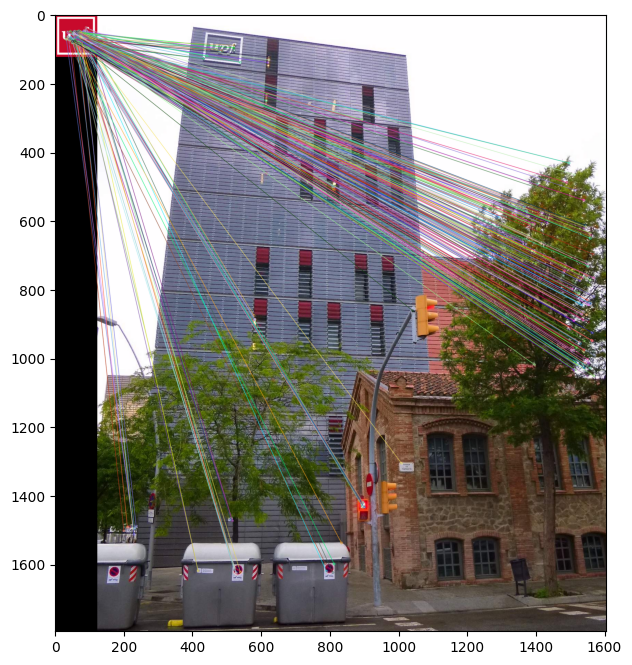

In [2]:
template = cv2.cvtColor(cv2.imread('./Data/logos/logoUPF.png', cv2.IMREAD_COLOR), cv2.COLOR_BGR2RGB)
target = cv2.cvtColor(cv2.imread('./Data/logos/UPFbuilding.jpg', cv2.IMREAD_COLOR), cv2.COLOR_BGR2RGB)
#print(template, target)

desc = 'orb'

target_kps, template_kps, m = LR.features_to_kp(target, LR.get_features(template, desc), desc = desc)
draw_matches(template, template_kps, target, target_kps, m)

Since the logo has such a low ammount of interesting features, it finds way more misscorrespondences than actual ones, resulting in the following issue

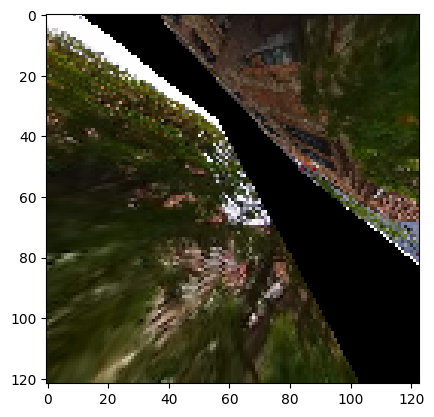

In [4]:
kp1, kp2, matches_12 = kp_match(template, target, descr='orb', dist_th=0.97) 
P1, P2, H_12, idxs_inlier_matches_12 = get_inliers_homography(kp1, kp2, matches_12)
#inlier_matches_12 = itemgetter(*idxs_inlier_matches_12)(matches_12)
dst = cv2.warpPerspective(target, np.linalg.inv(H_12), template.shape[:-1][::-1])

plt.imshow(dst)
plt.show()

Nevertheless, with any change in the pipeline, the result can be heavily improved by using ```SIFT``` instead

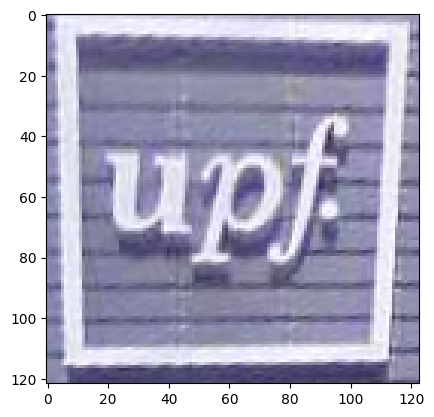

In [5]:
kp1, kp2, matches_12 = kp_match(template, target, descr='SIFT', dist_th=0.97) 
P1, P2, H_12, idxs_inlier_matches_12 = get_inliers_homography(kp1, kp2, matches_12)
#inlier_matches_12 = itemgPer la setmana vinent ja no treballarem així etter(*idxs_inlier_matches_12)(matches_12)
dst = cv2.warpPerspective(target, np.linalg.inv(H_12), template.shape[:-1][::-1])

plt.imshow(dst)
plt.show()

Can we do better? 

Let's try to remove all the non-relevant points from the image. ```match template``` will perform a convolution in the image in order to find the peak energy response and, therefore, locate a good candidate for the template to be.

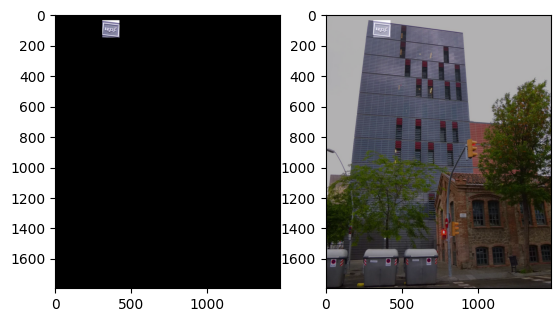

In [3]:
mask, reduced_target = LR.match_template(template, target, margin = -5)
fig, axs = plt.subplots(ncols=2)
axs[0].imshow(reduced_target)
axs[1].imshow((mask * 0.3 + target * 0.7).astype(np.uint8))
plt.show()

Seems like vertical lines get slightly better

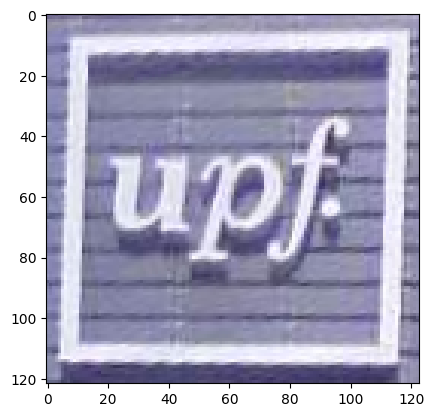

In [5]:
kp1, kp2, matches_12 = kp_match(template, reduced_target, descr='SIFT', dist_th=0.97) 
P1, P2, H_12, idxs_inlier_matches_12 = get_inliers_homography(kp1, kp2, matches_12)
#inlier_matches_12 = itemgetter(*idxs_inlier_matches_12)(matches_12)
dst = cv2.warpPerspective(target, np.linalg.inv(H_12), template.shape[:-1][::-1])

plt.imshow(dst)
plt.show()

As a result, we should be expecting a very heavy translation vector $t_x, t_y$; which is true!

In [9]:
H_12

array([[ 6.65909274e-01, -7.13329454e-02,  1.81471718e+02],
       [ 9.58779780e-02,  4.24954997e-01,  2.56552968e+01],
       [ 2.19173841e-04, -1.30343899e-04,  5.89624670e-01]])

## **6. OPTIONAL. Application: Logo replacement**

<span style='color:Green'> - Replace the UPF logo by the master logo in one of the previous images using the DLT algorithm. </span>


Using the previously found homography we can translate the template back to its place, replacing it to the red version

In [8]:
replace = cv2.resize(cv2.cvtColor(cv2.imread('./Data/logos/logo_master.png', cv2.IMREAD_COLOR), cv2.COLOR_BGR2RGB), template.shape[:-1])
hand = cv2.resize(cv2.cvtColor(cv2.imread('./Data/logos/hand.png', cv2.IMREAD_COLOR), cv2.COLOR_BGR2RGB), template.shape[:-1])
tmp = copy.deepcopy(target)


(1794, 1482, 3)


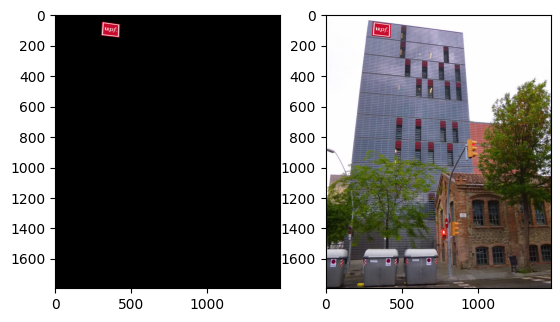

In [9]:
dst1 = cv2.warpPerspective(template, H_12, target.shape[:-1][::-1])
print(mask.shape)

fig, axs = plt.subplots(ncols=2)
axs[0].imshow(dst1)
axs[1].imshow(tmp * (dst==0) + dst1)
plt.show()

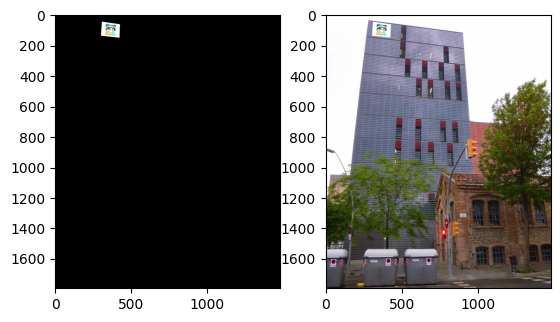

In [17]:
dst = cv2.warpPerspective(replace, H_12, target.shape[:-1][::-1])

fig, axs = plt.subplots(ncols=2)
axs[0].imshow(dst)
axs[1].imshow(tmp * (dst==0) + dst)
plt.show()

For any image

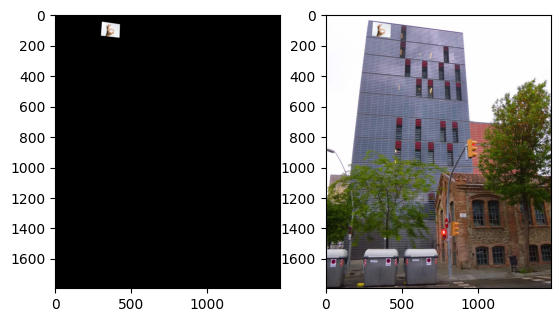

In [11]:
dst3 = cv2.warpPerspective(hand, H_12, target.shape[:-1][::-1])

fig, axs = plt.subplots(ncols=2)
axs[0].imshow(dst3)
axs[1].imshow(tmp * (dst3==0) + dst3)
plt.show()

In [12]:
cv2.imwrite( 'replacement.png', cv2.cvtColor(np.hstack([tmp, tmp * (dst3==0) + dst3 ,tmp * (dst==0) + dst1, tmp * (dst==0) + dst]), cv2.COLOR_RGB2BGR))

True